In [1]:
import pandas as pd
import csv
import numpy as np
from scipy import ndimage
from numpy import asarray
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import pyabf
from datetime import timedelta
import cv2
import os
from PIL import Image
from matplotlib import pyplot as plt
from matplotlib import image as mpimg
from neo.io import AxonIO
from matplotlib.gridspec import GridSpec
import urllib
import neo

In [2]:
df_abf1 = pd.read_csv (r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\df_abf_230919_515.csv')
df_LE1 = pd.read_csv (r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\df_LE.csv')
df_RE1 = pd.read_csv (r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\df_RE.csv')

df_abf2 = pd.read_csv (r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\df_abf_230922_321.csv')
df_LE2 = pd.read_csv (r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\df_LE.csv')
df_RE2 = pd.read_csv (r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\df_RE.csv')


# Make function for threshold and return first frame number

In [3]:
def find_first_frame(df, column_name, x_axis_name = 'run_time_ms' , adjustment=0, threshold_multiplier=6) :
    median_intensity = np.nanmedian(df[column_name])
    q1 = np.nanpercentile(df[column_name], 25)
    q3 = np.nanpercentile(df[column_name], 75)
    iqr_value = q3 - q1
    thresh_intensity = median_intensity - threshold_multiplier * iqr_value
    thresh_intensity = thresh_intensity-adjustment  # for noisy recordings

    plt.plot(df[column_name])
    plt.axhline(y=thresh_intensity, color='r')
    plt.show()

    first_frame_number = np.where(df[column_name] < thresh_intensity)[0][0]

    plt.plot(df[column_name][first_frame_number - 2:first_frame_number + 2])
    plt.axhline(y=thresh_intensity, color='r')
    plt.show()

    return first_frame_number

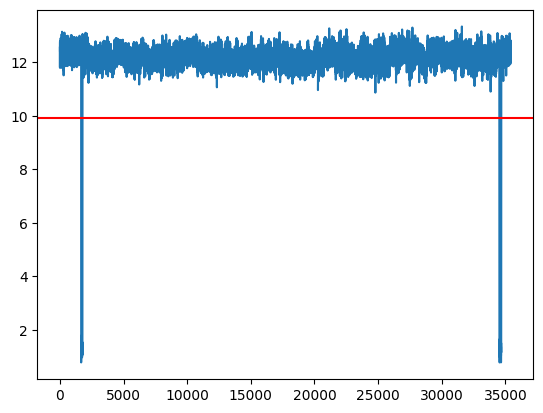

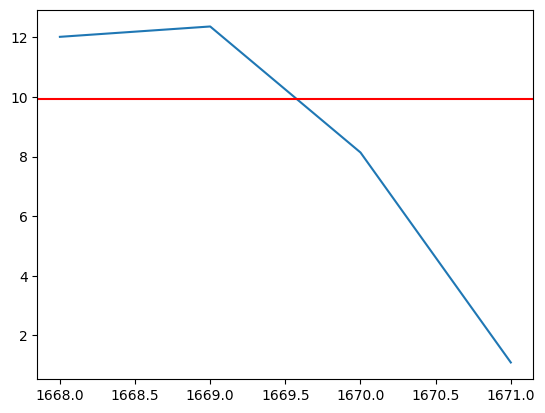

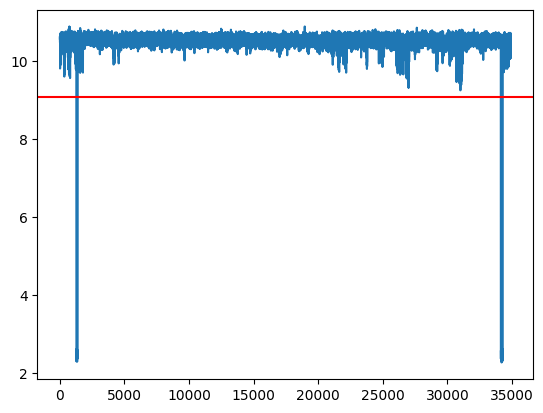

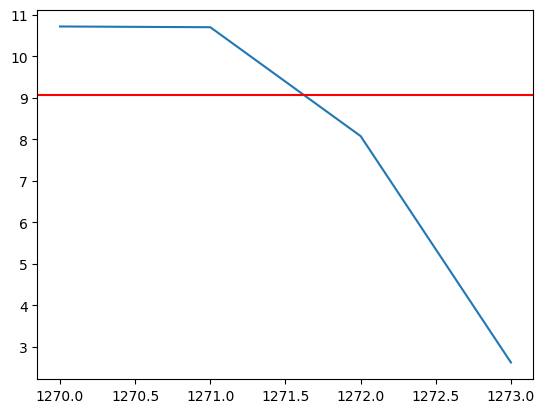

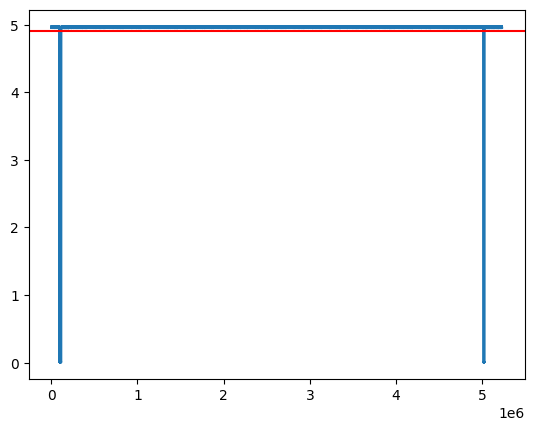

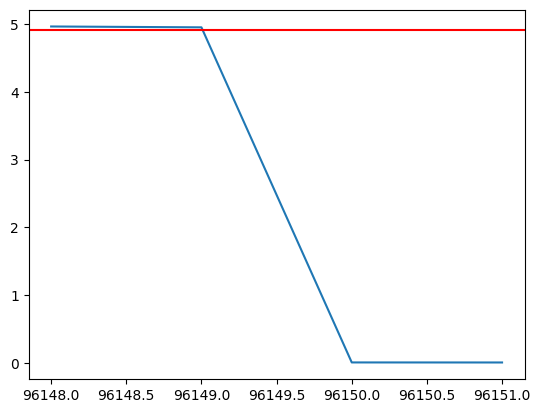

In [4]:
first_frame_df_LE1=find_first_frame(df_LE1,'image_intensity')
first_frame_df_RE1=find_first_frame(df_RE1,'image_intensity',adjustment=0.7)
first_frame_df_abf1=find_first_frame(df_abf1,'led')

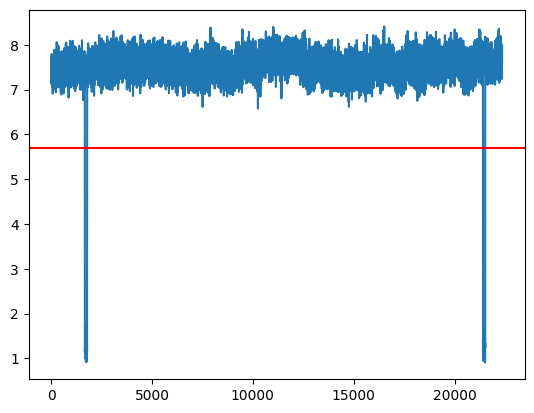

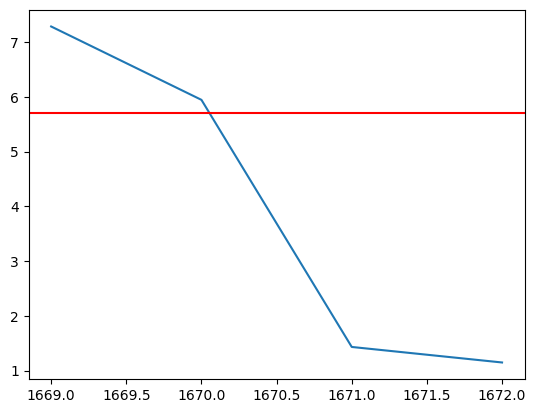

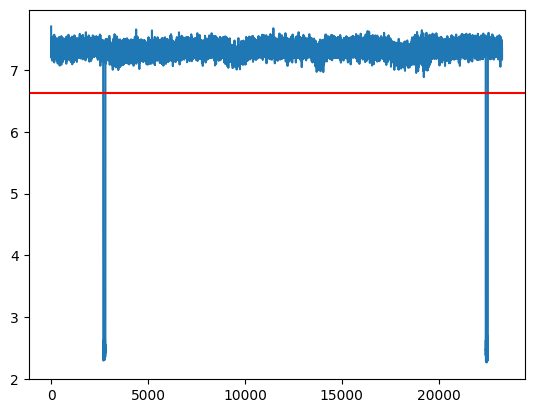

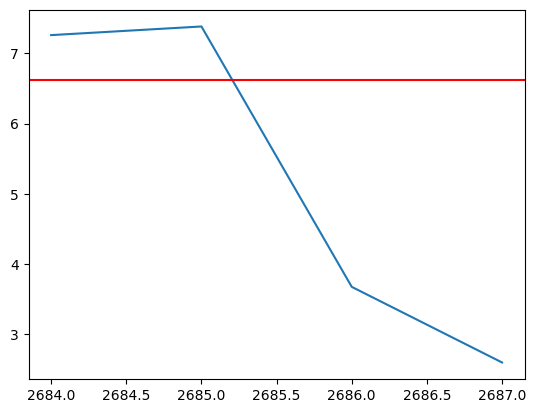

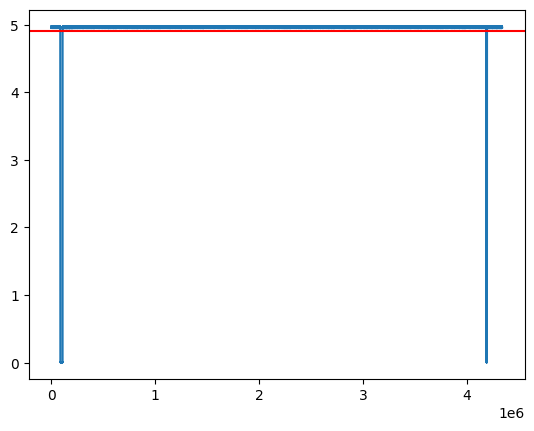

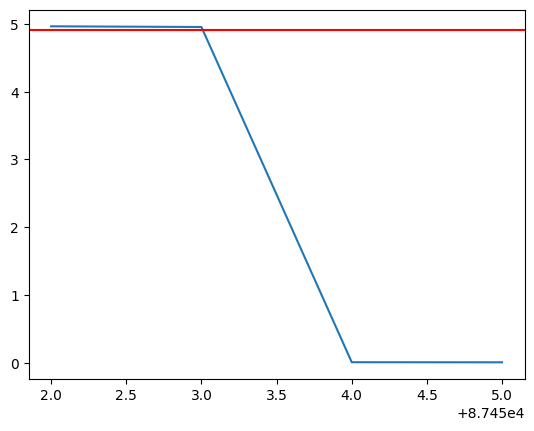

In [5]:
first_frame_df_LE2=find_first_frame(df_LE2,'image_intensity')
first_frame_df_RE2=find_first_frame(df_RE2,'image_intensity')
first_frame_df_abf2=find_first_frame(df_abf2,'led')

# Add new milliseconds time columns to the dataframes that start with their first frames

In [6]:
df_RE1['time_milliseconds_zero'] = (df_RE1['run_time_ms'] - df_RE1['run_time_ms'].iloc[first_frame_df_RE1])
df_LE1['time_milliseconds_zero'] = (df_LE1['run_time_ms'] - df_LE1['run_time_ms'].iloc[first_frame_df_LE1])
df_abf1['time_milliseconds_zero'] = (df_abf1.index - first_frame_df_abf1) / 10  # Assuming 10 Hz sampling rate, adjust as needed

In [7]:
df_RE2['time_milliseconds_zero'] = (df_RE2['run_time_ms'] - df_RE2['run_time_ms'].iloc[first_frame_df_RE2])
df_LE2['time_milliseconds_zero'] = (df_LE2['run_time_ms'] - df_LE2['run_time_ms'].iloc[first_frame_df_LE2])
df_abf2['time_milliseconds_zero'] = (df_abf2.index - first_frame_df_abf2) / 10  # Assuming 10 Hz sampling rate, adjust as needed

# Junction potential

In [8]:
df_abf1['Vm_corrected'] = df_abf1['Vm_prime'] - 13
df_abf2['Vm_corrected'] = df_abf2['Vm_prime'] - 13

In [9]:
df_abf1.to_csv(r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\df_abf_230919_515.csv', index=False)
df_abf2.to_csv(r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\df_abf_230922_321.csv', index=False)

# Movement in degrees

Counted once for this 28 pixels = 15 degrees

In [12]:
def transform_pix_to_degrees(df, x_col='pupil_x_tranfo', y_col='pupil_y_tranfo', pixels =28):
    df['pupil_RE_x_corrected'] = (df[x_col] / pixels) * 15 #makes a new column called 'pupil_RE_x_corrected'and converts pixels into degrees
    df_median_x = df['pupil_RE_x_corrected'].median() # calculates the median
    df['pupil_RE_x_corrected'] = df['pupil_RE_x_corrected'] - df_median_x #substracts median from the new column 

    df['pupil_LE_x_corrected'] = (df[y_col] / pixels) * 15
    df_median_y = df['pupil_LE_x_corrected'].median()
    df['pupil_LE_x_corrected'] = df['pupil_LE_x_corrected'] - df_median_y

    return df

In [15]:
df_RE1=transform_pix_to_degrees(df_RE1)
df_LE1=transform_pix_to_degrees(df_LE1)
df_RE2=transform_pix_to_degrees(df_RE2)
df_LE2=transform_pix_to_degrees(df_LE2)

In [16]:
df_RE1.to_csv(r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\df_RE.csv', index=False)
df_LE1.to_csv(r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\df_LE.csv', index=False)
df_RE2.to_csv(r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\df_RE.csv', index=False)
df_LE2.to_csv(r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\df_LE.csv', index=False)

# Plot everything onwards from the first frames defined above, Overview

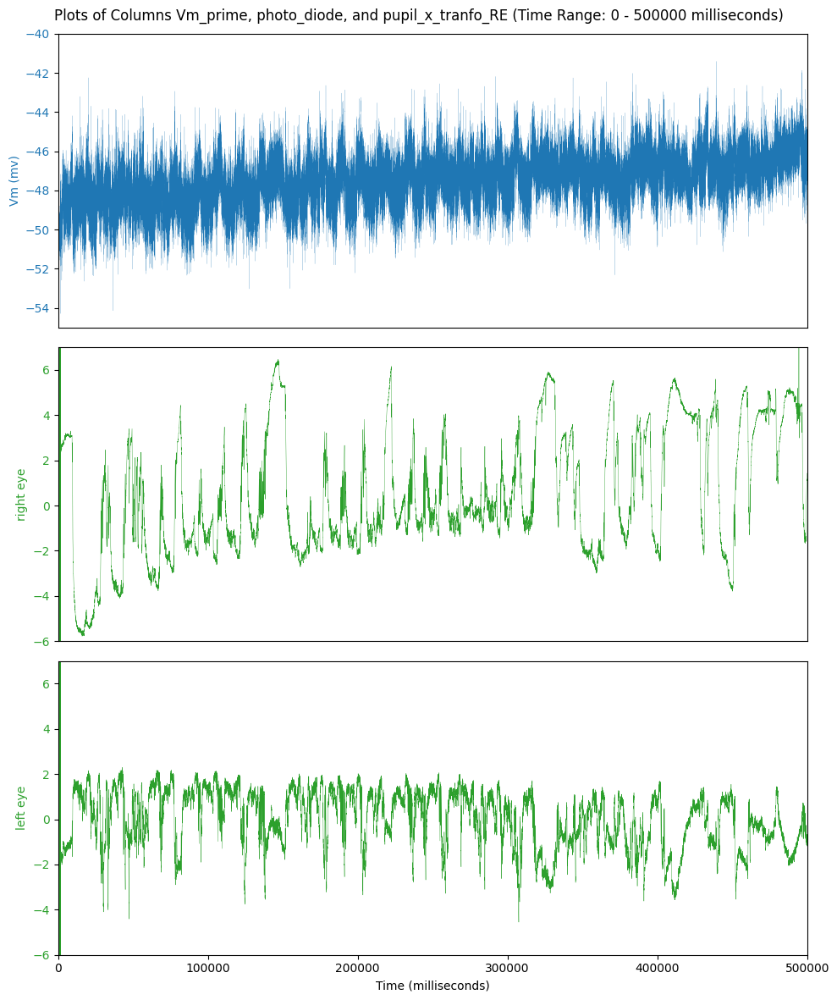

In [29]:
# Create a figure with four vertically stacked subplots
fig, axs = plt.subplots(3, 1, figsize=(10, 12), sharex=False)  # Set sharex to False

# Define the time range you want to display
time_start = 0
time_end = 500000

# Define the y-axis limits for df_RE
y_start =-6
y_end= 7


# Plot 'Vm_prime' on the first subplot (df_abf)
axs[0].plot(df_abf1['time_milliseconds_zero'][first_frame_df_abf1:], df_abf1['Vm_corrected'][first_frame_df_abf1:], label='Vm_prime', color='tab:blue',linewidth=0.1)
axs[0].set_ylabel('Vm (mv)', color='tab:blue')
axs[0].tick_params(axis='y', labelcolor='tab:blue')
axs[0].set_xlim(time_start, time_end)  # Set x-axis limits
axs[0].set_xticks([])  # Remove x-axis ticks
axs[0].set_ylim(-55, -40)


# Plot 'pupil_x_tranfo_RE' from df_RE on the third subplot
axs[1].plot(df_RE1['time_milliseconds_zero'][first_frame_df_RE1:], df_RE1['pupil_RE_x_corrected'][first_frame_df_RE1:], label='pupil_RE_x_corrected', color='tab:green',linewidth=0.3)
axs[1].set_ylabel('right eye', color='tab:green')
axs[1].tick_params(axis='y', labelcolor='tab:green')
axs[1].set_xlim(time_start, time_end)  # Set x-axis limits
axs[1].set_xticks([])  # Remove x-axis ticks
axs[1].set_ylim(y_start, y_end) 

# Plot 'pupil_x_tranfo_LE' from df_LE on the fourth subplot
axs[2].plot(df_LE1['time_milliseconds_zero'][first_frame_df_LE1:], df_LE1['pupil_LE_x_corrected'][first_frame_df_LE1:], label='pupil_LE_x_corrected', color='tab:green',linewidth=0.3)
axs[2].set_xlabel('Time (milliseconds)')
axs[2].set_ylabel('left eye', color='tab:green')
axs[2].tick_params(axis='y', labelcolor='tab:green')
axs[2].set_xlim(time_start, time_end)  # Set x-axis limits
axs[2].set_ylim(y_start, y_end)  

# Set title for the entire figure
plt.suptitle(f'Plots of Columns Vm_prime, photo_diode, and pupil_x_tranfo_RE (Time Range: {time_start} - {time_end} milliseconds)')

# Adjust spacing between subplots
plt.tight_layout()


# Define the file path and name
file_path = r'D:\230919_firstRecordingsinFlight\5attempt\rec5\Analysis\Overview.pdf'

# Save the figure as a .pdf
plt.savefig(file_path, format='pdf')

# Show the plot
plt.show()


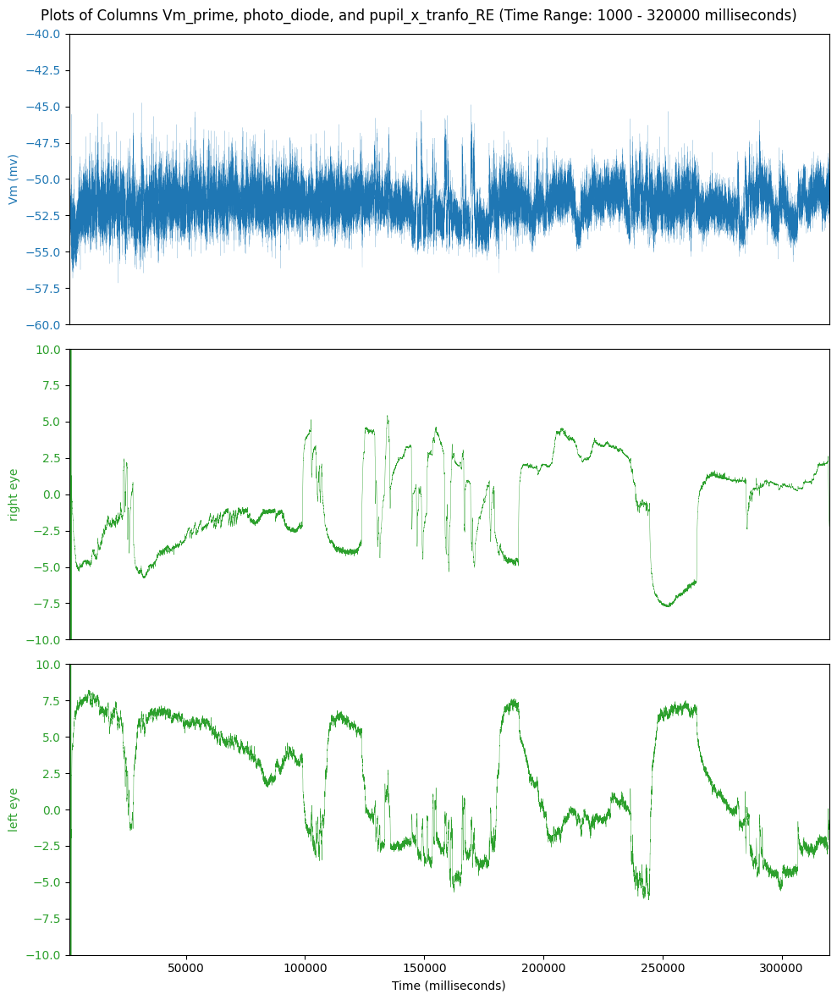

In [43]:
# Create a figure with four vertically stacked subplots
fig, axs = plt.subplots(3, 1, figsize=(10, 12), sharex=False)  # Set sharex to False

# Define the time range you want to display
time_start = 1000
time_end = 320000

# Define the y-axis limits for df_RE
y_start =-10
y_end= 10


# Plot 'Vm_prime' on the first subplot (df_abf)
axs[0].plot(df_abf2['time_milliseconds_zero'][first_frame_df_abf2:], df_abf2['Vm_corrected'][first_frame_df_abf2:], label='Vm_prime', color='tab:blue',linewidth=0.1)
axs[0].set_ylabel('Vm (mv)', color='tab:blue')
axs[0].tick_params(axis='y', labelcolor='tab:blue')
axs[0].set_xlim(time_start, time_end)  # Set x-axis limits
axs[0].set_xticks([])  # Remove x-axis ticks
axs[0].set_ylim(-60, -40)


# Plot 'pupil_x_tranfo_RE' from df_RE on the third subplot
axs[1].plot(df_RE2['time_milliseconds_zero'][first_frame_df_RE2:], df_RE2['pupil_RE_x_corrected'][first_frame_df_RE2:], label='pupil_RE_x_corrected', color='tab:green',linewidth=0.3)
axs[1].set_ylabel('right eye', color='tab:green')
axs[1].tick_params(axis='y', labelcolor='tab:green')
axs[1].set_xlim(time_start, time_end)  # Set x-axis limits
axs[1].set_xticks([])  # Remove x-axis ticks
axs[1].set_ylim(y_start, y_end) 

# Plot 'pupil_x_tranfo_LE' from df_LE on the fourth subplot
axs[2].plot(df_LE2['time_milliseconds_zero'][first_frame_df_LE2:], df_LE2['pupil_LE_x_corrected'][first_frame_df_LE2:], label='pupil_LE_x_corrected', color='tab:green',linewidth=0.3)
axs[2].set_xlabel('Time (milliseconds)')
axs[2].set_ylabel('left eye', color='tab:green')
axs[2].tick_params(axis='y', labelcolor='tab:green')
axs[2].set_xlim(time_start, time_end)  # Set x-axis limits
axs[2].set_ylim(y_start, y_end)  

# Set title for the entire figure
plt.suptitle(f'Plots of Columns Vm_prime, photo_diode, and pupil_x_tranfo_RE (Time Range: {time_start} - {time_end} milliseconds)')

# Adjust spacing between subplots
plt.tight_layout()


# Define the file path and name
file_path2 = r'D:\230923_Patch\3rprep\2ndattempt\1strecording\Analysis\Overview.pdf'

# Save the figure as a .pdf
plt.savefig(file_path2, format='pdf')

# Show the plot
plt.show()


# Get a loop that goes over and give me the plots+saves them

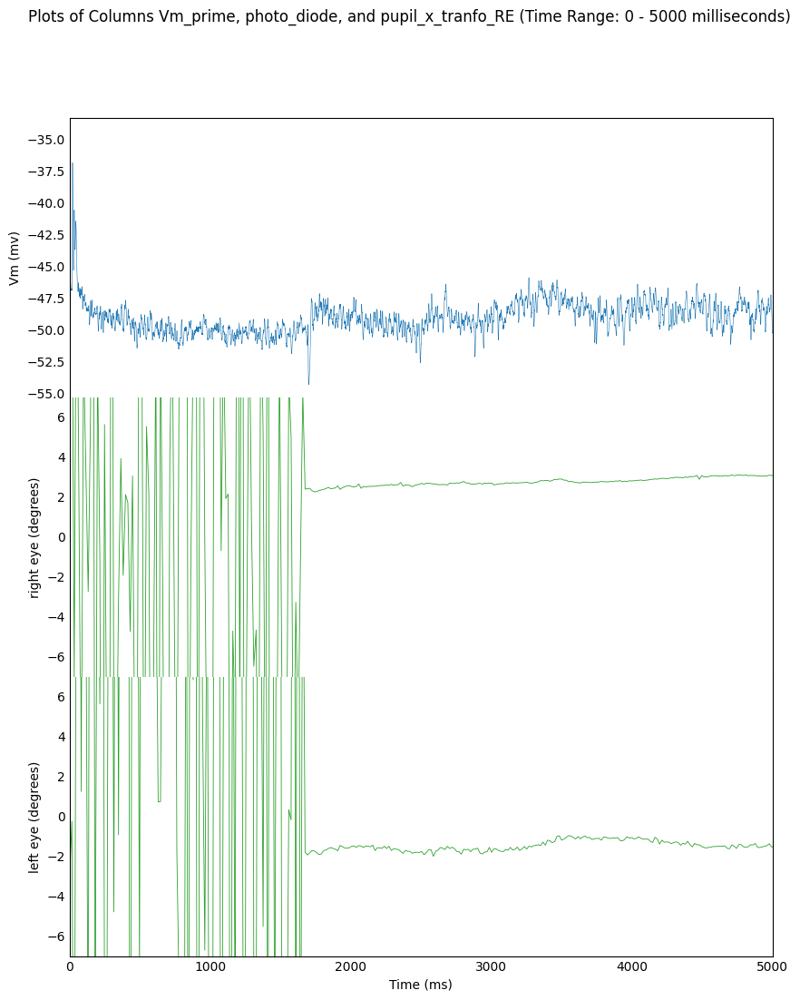

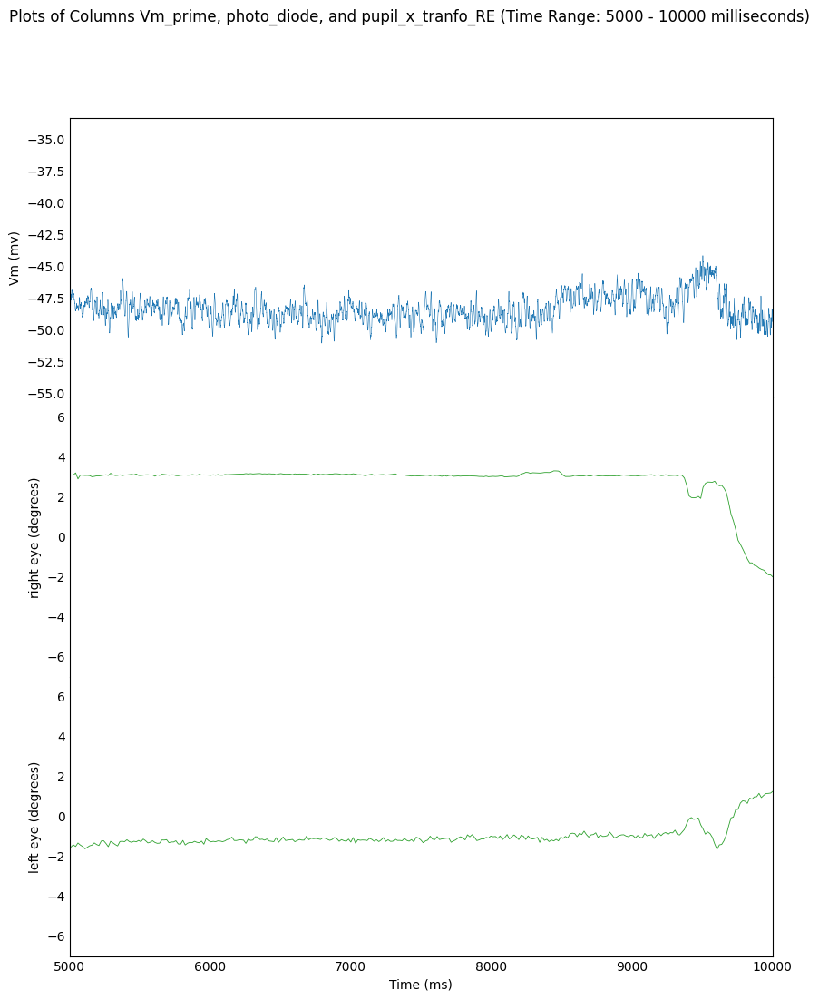

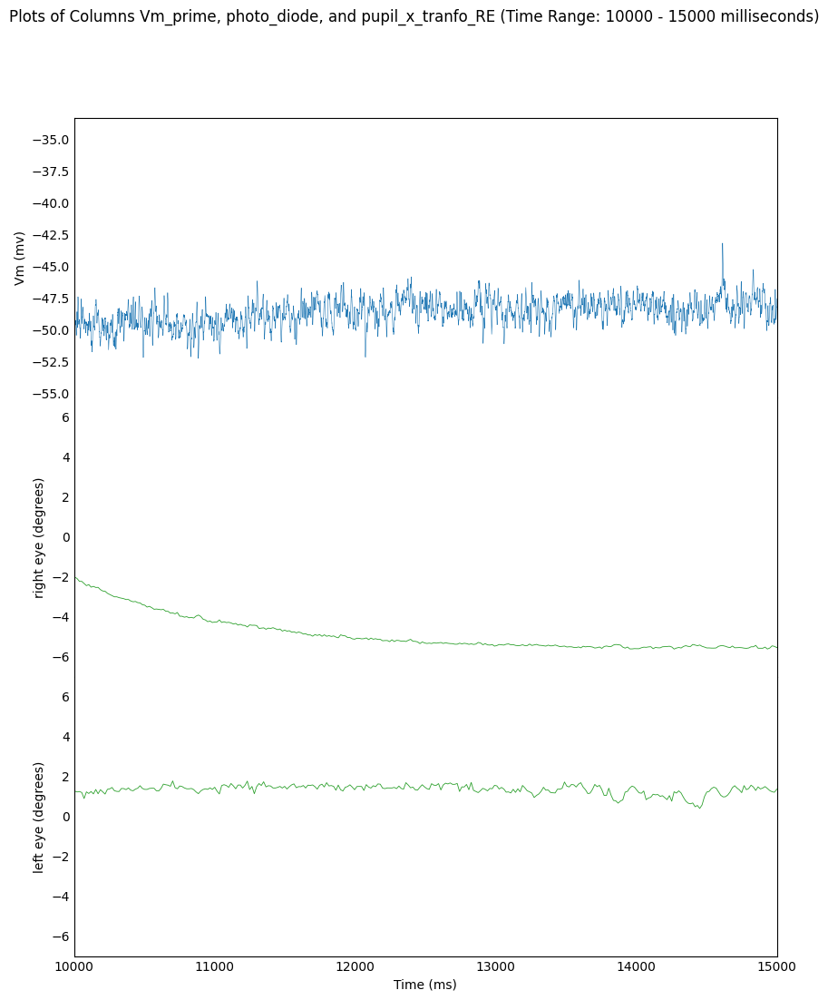

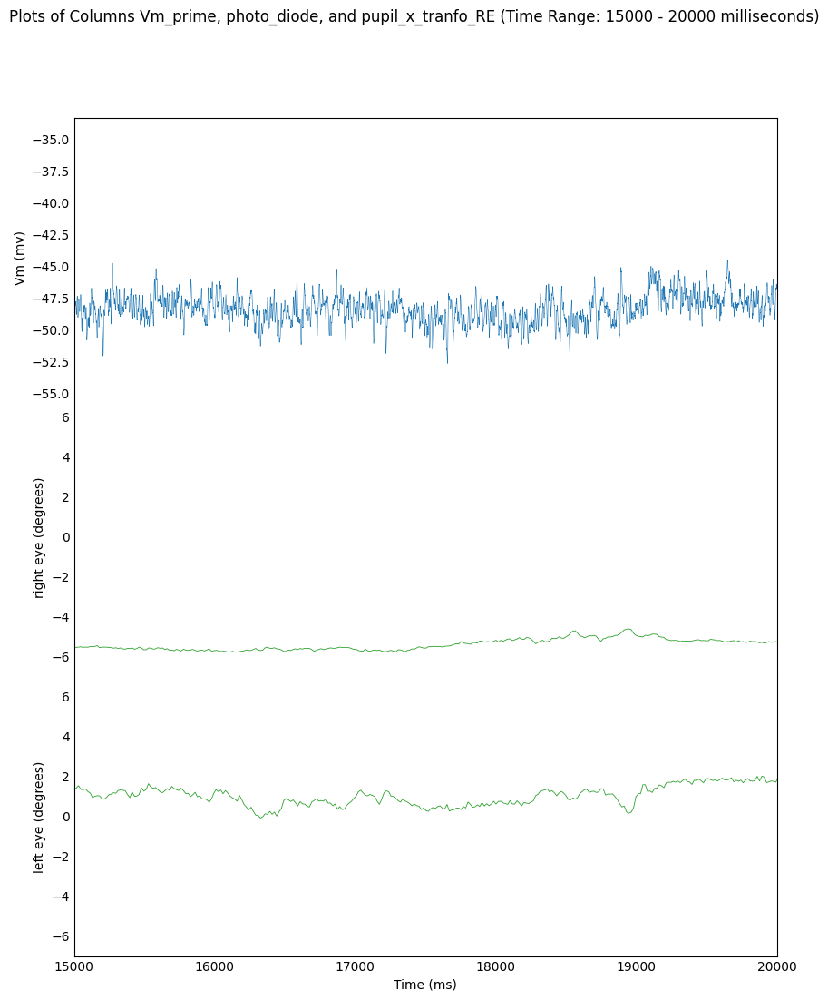

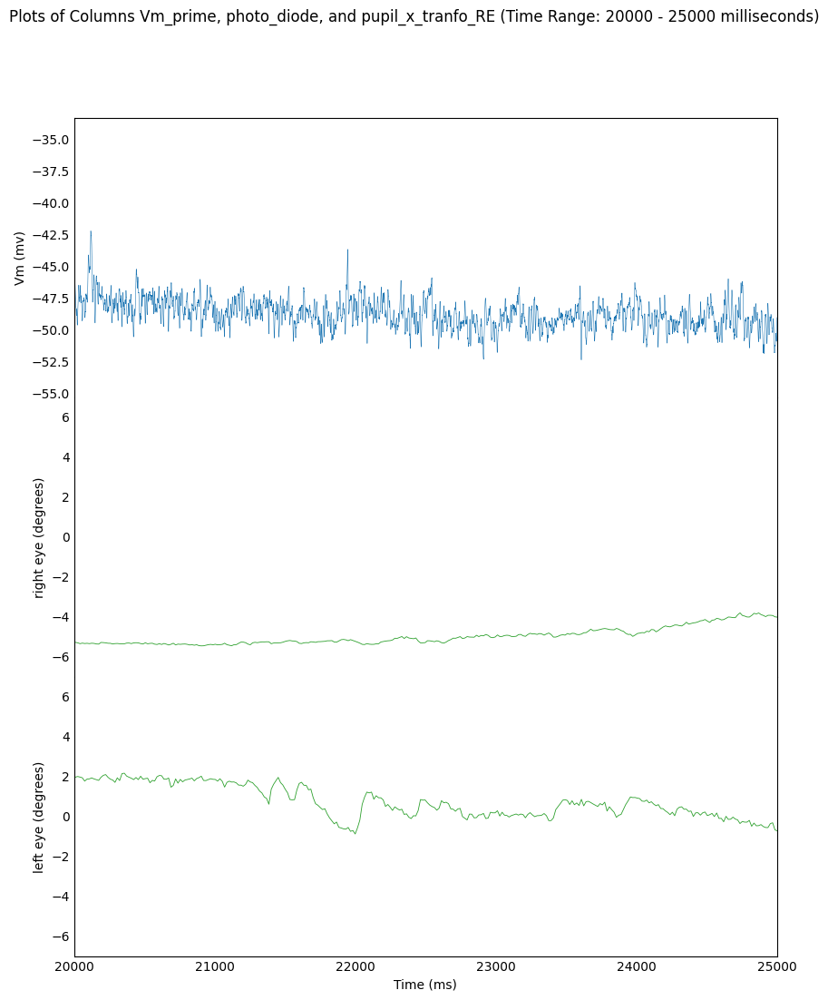

...

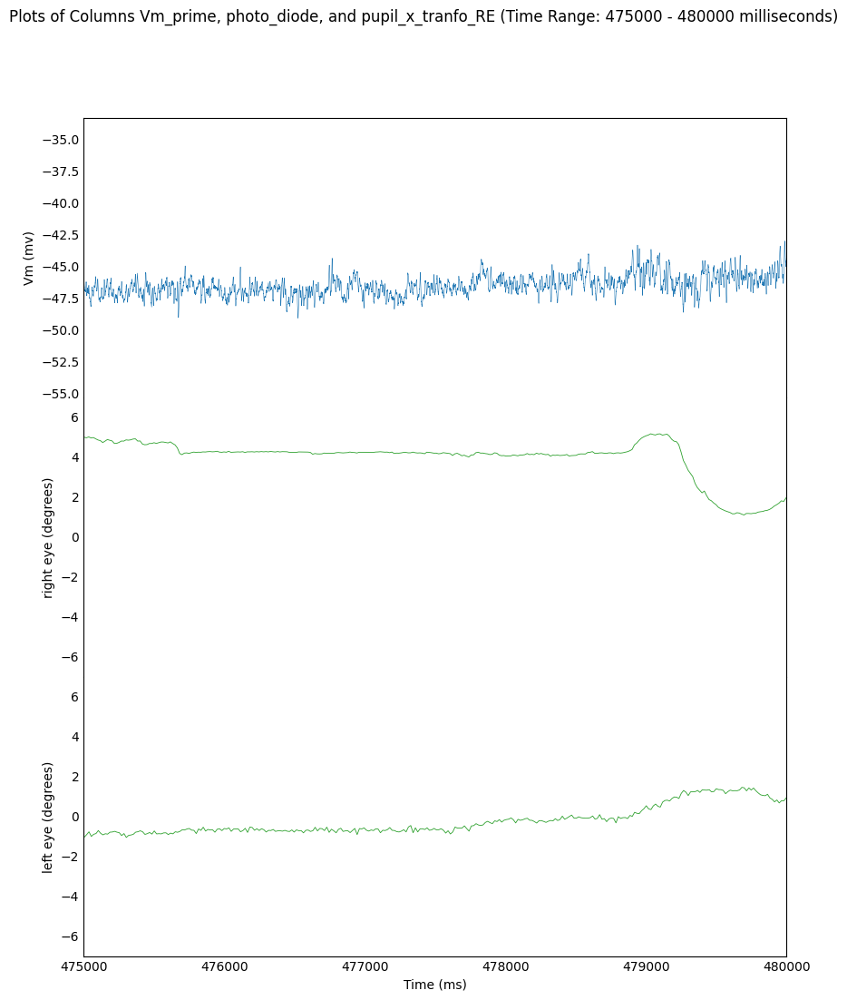

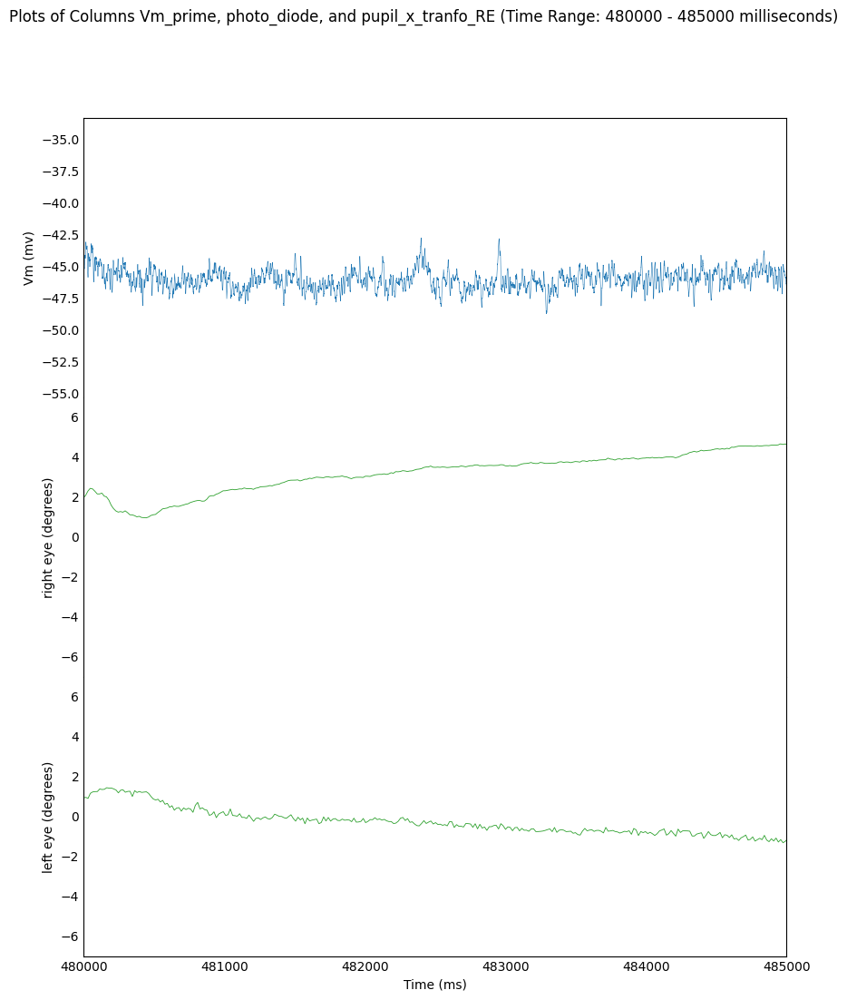

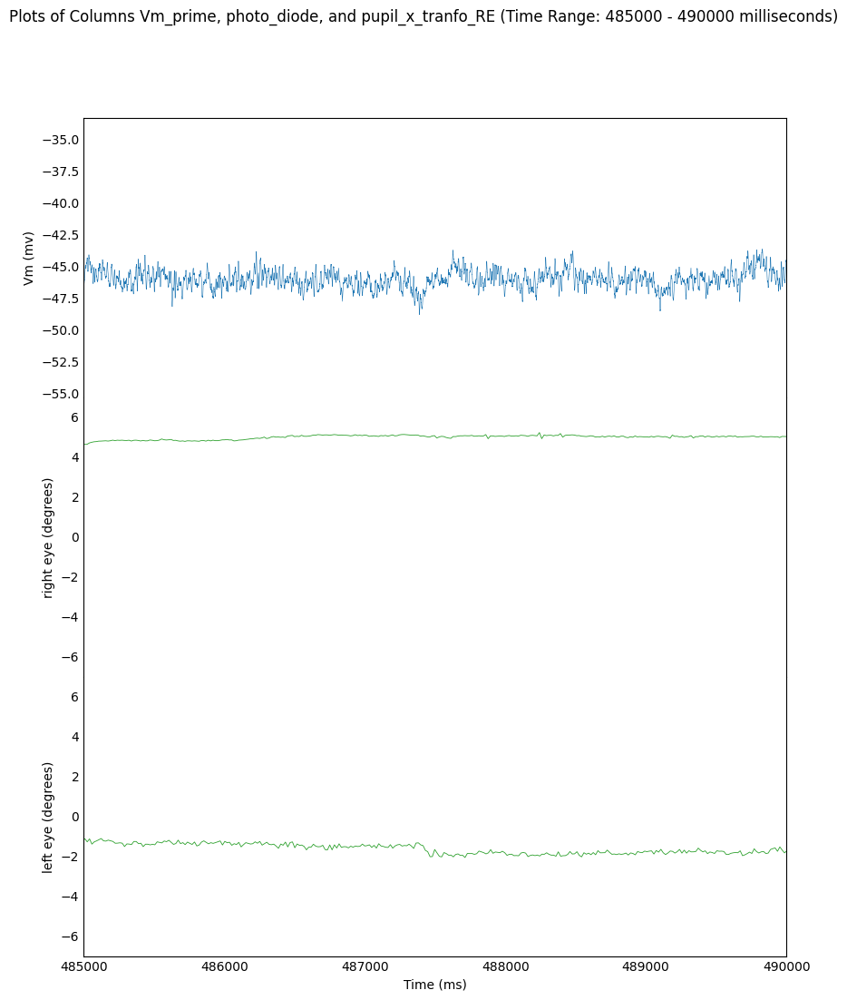

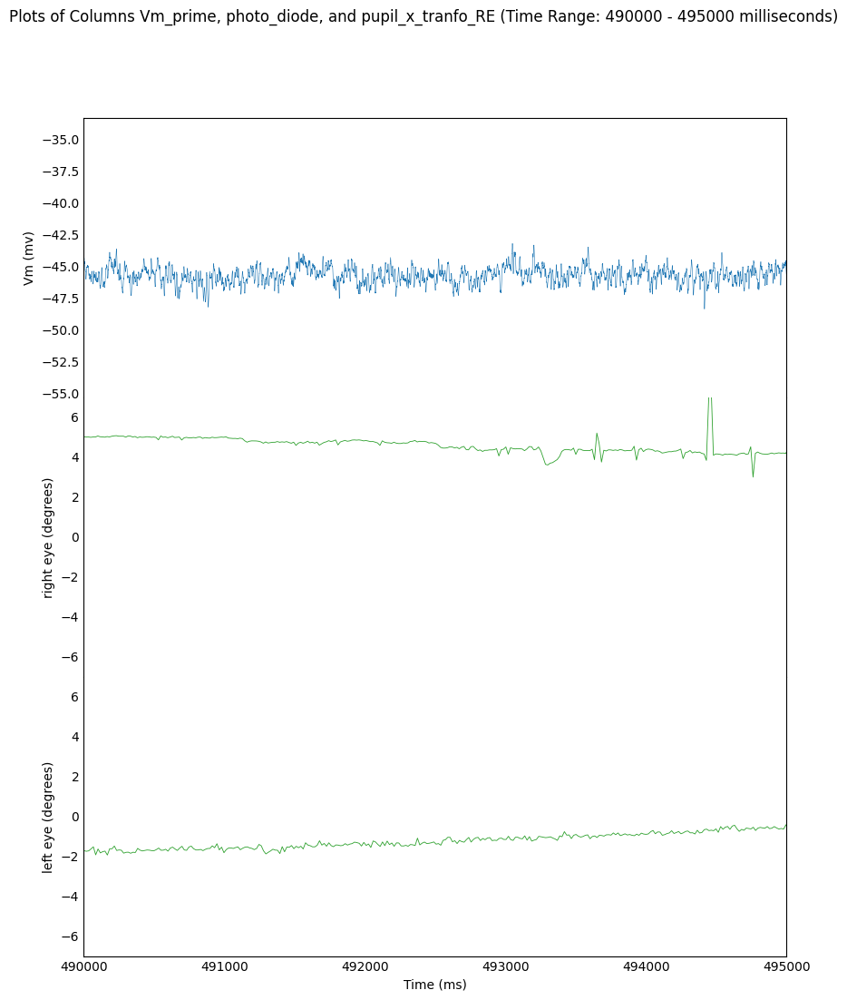

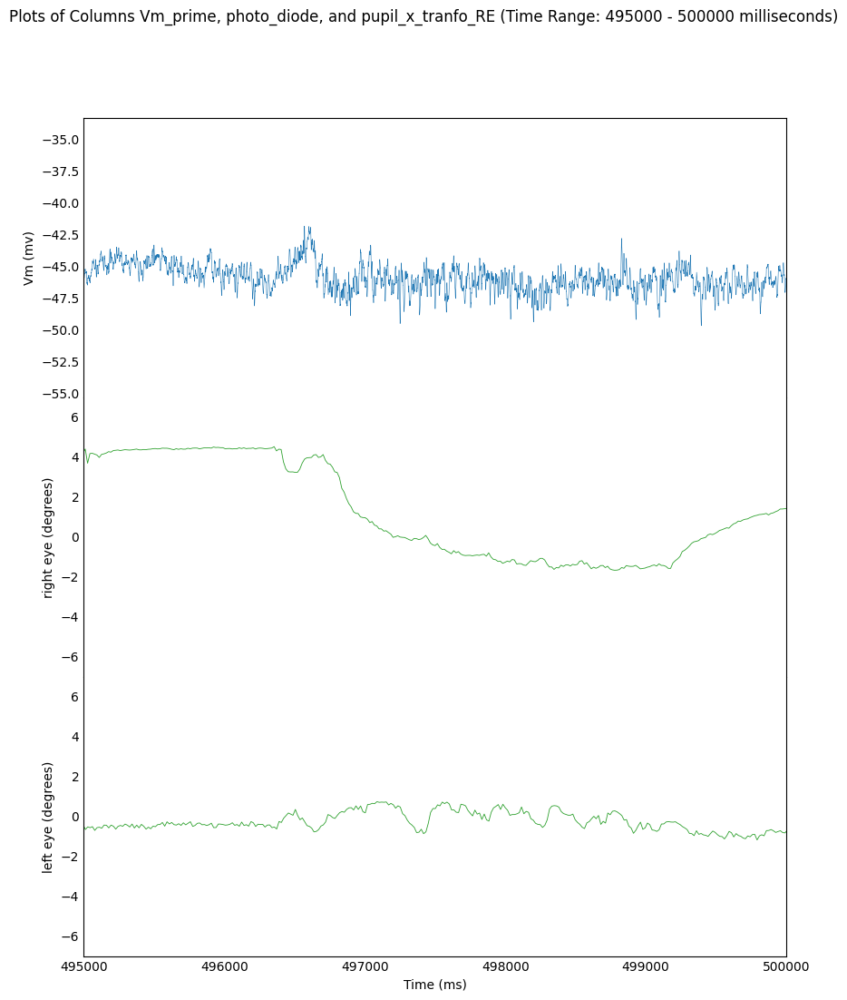

In [47]:
# Initialize the starting time
time_start = 0
time_end = time_start + 5000

# Loop until you reach a desired end time
while time_end <= 500000:  # Adjust the end time as needed
    # Create a figure with four vertically stacked subplots
    fig, axs = plt.subplots(3, 1, figsize=(10, 12), sharex=False)

    # Define the y-axis limits for df_RE
    y_start = -7
    y_end = 7

    # Plot 'Vm_prime' on the first subplot (df_abf)
    axs[0].plot(df_abf1['time_milliseconds_zero'][first_frame_df_abf1:], df_abf1['Vm_corrected'][first_frame_df_abf1:], label='Vm_prime', color='tab:blue',linewidth=0.4)
    axs[0].set_ylabel('Vm (mv)')
    axs[0].tick_params(axis='y')
    axs[0].set_xlim(time_start, time_end)
    axs[0].set_xticks([])
    
    axs[0].spines['top'].set_visible(True)
    axs[0].spines['right'].set_visible(True)
    axs[0].spines['bottom'].set_visible(False)
    axs[0].spines['left'].set_visible(True)
    axs[0].tick_params(axis='both', which='both', length=0)

    
    # Plot 'pupil_x_tranfo_RE' from df_RE on the third subplot
    axs[1].plot(df_RE1['time_milliseconds_zero'][first_frame_df_RE1:], df_RE1['pupil_RE_x_corrected'][first_frame_df_RE1:], label='pupil_RE_x_corrected', color='tab:green',linewidth=0.6)
    axs[1].set_ylabel('right eye (degrees)')
    axs[1].tick_params(axis='y')
    axs[1].set_xlim(time_start, time_end)
    axs[1].set_xticks([])
    axs[1].set_ylim(y_start, y_end)
    
    axs[1].spines['top'].set_visible(False)
    axs[1].spines['right'].set_visible(True)
    axs[1].spines['bottom'].set_visible(False)
    axs[1].spines['left'].set_visible(True)
    axs[1].tick_params(axis='both', which='both', length=0)

    # Plot 'pupil_x_tranfo_LE' from df_LE on the fourth subplot
    axs[2].plot(df_LE1['time_milliseconds_zero'][first_frame_df_LE1:], df_LE1['pupil_LE_x_corrected'][first_frame_df_LE1:], label='pupil_LE_x_corrected', color='tab:green',linewidth=0.6)
    axs[2].set_xlabel('Time (ms)')
    axs[2].set_ylabel('left eye (degrees)')
    axs[2].tick_params(axis='y')
    axs[2].set_xlim(time_start, time_end)
    axs[2].set_ylim(y_start, y_end)
    
    axs[2].spines['top'].set_visible(False)
    axs[2].spines['right'].set_visible(True)
    axs[2].spines['bottom'].set_visible(True)
    axs[2].spines['left'].set_visible(True)
    axs[2].tick_params(axis='both', which='both', length=0)

    # Set title for the entire figure
    plt.suptitle(f'Plots of Columns Vm_prime, photo_diode, and pupil_x_tranfo_RE (Time Range: {time_start} - {time_end} milliseconds)')
    
     # Adjust spacing between subplots
    plt.subplots_adjust(hspace=0)

    # Adjust spacing between subplots
    #plt.tight_layout()

    # Define the file path and name
    file_path3 = f'D:\\230919_firstRecordingsinFlight\\5attempt\\rec5\\Analysis\\{time_start}_{time_end}.pdf'

    # Save the figure as a .pdf
    plt.savefig(file_path3, format='pdf')

    # Show the plot (optional)
    plt.show()

    # Increment time_start and time_end for the next iteration
    time_start += 5000
    time_end += 5000


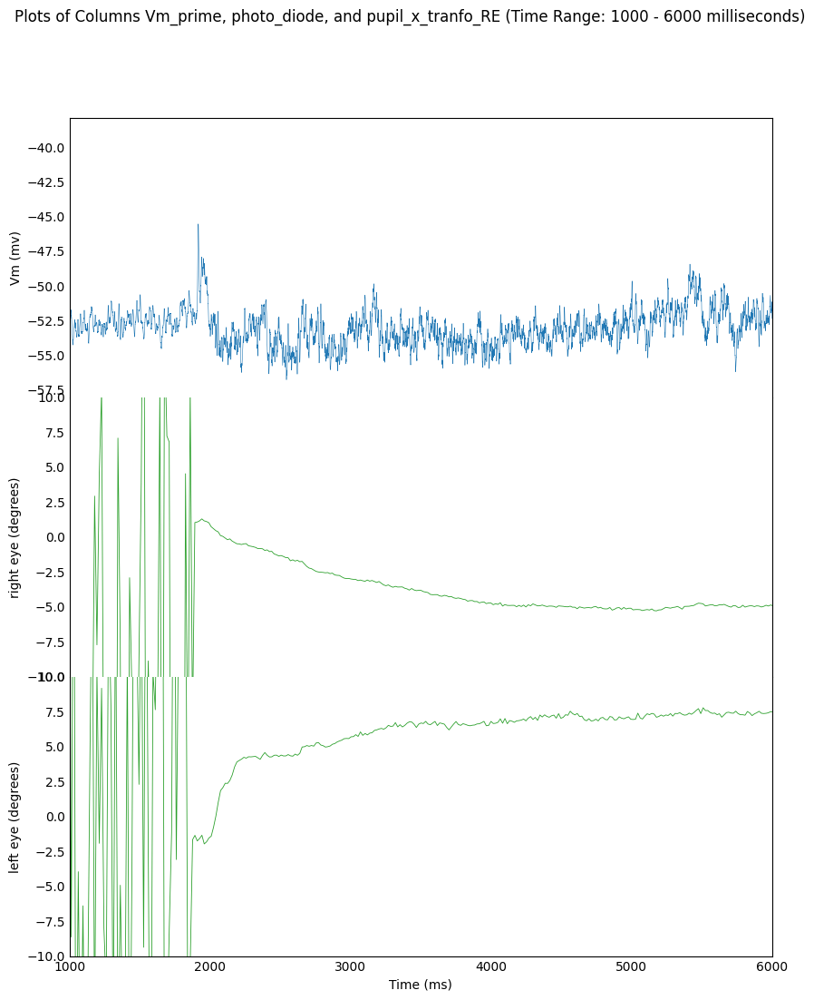

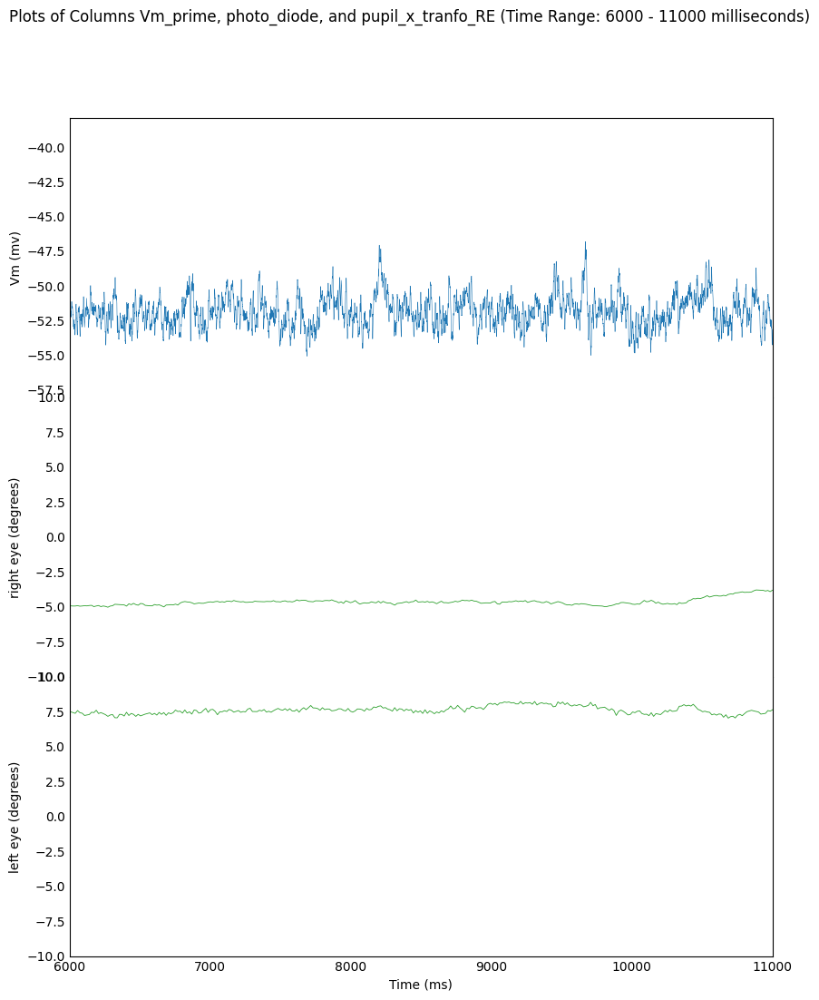

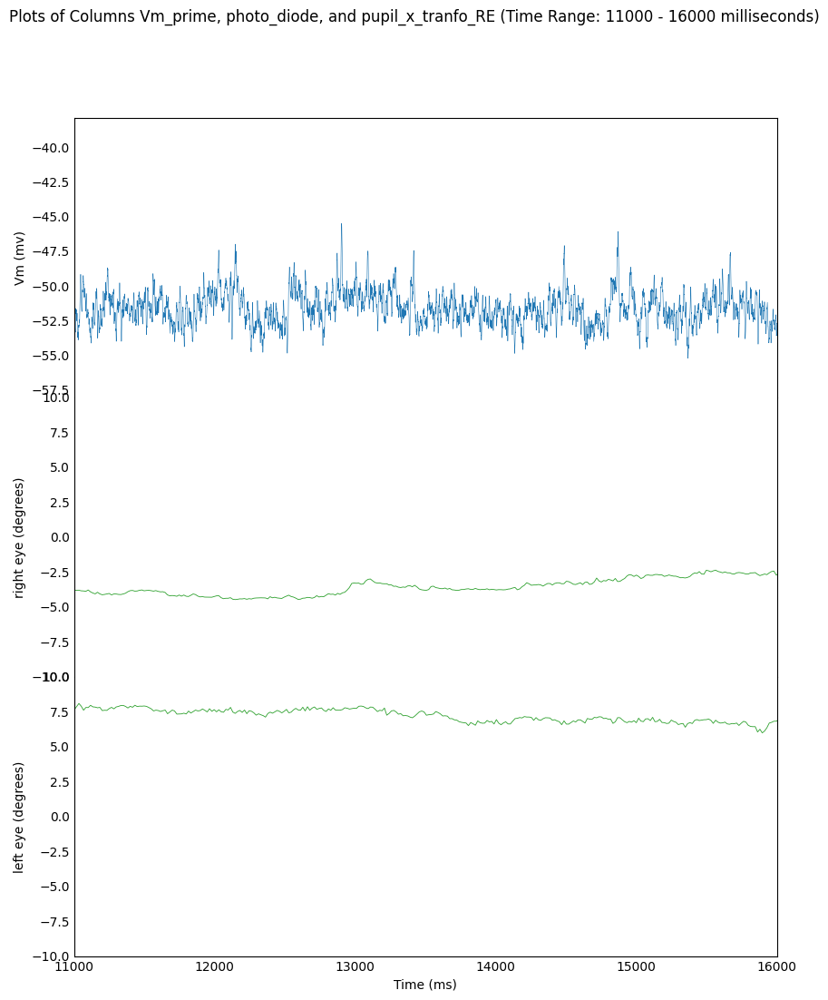

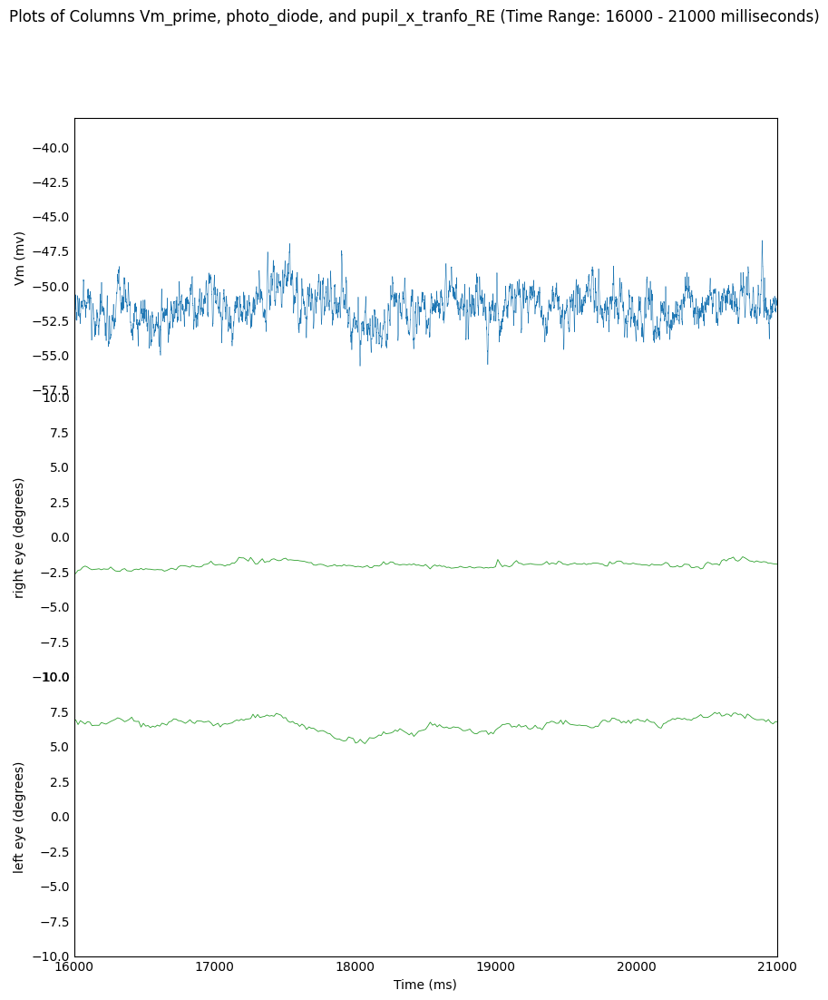

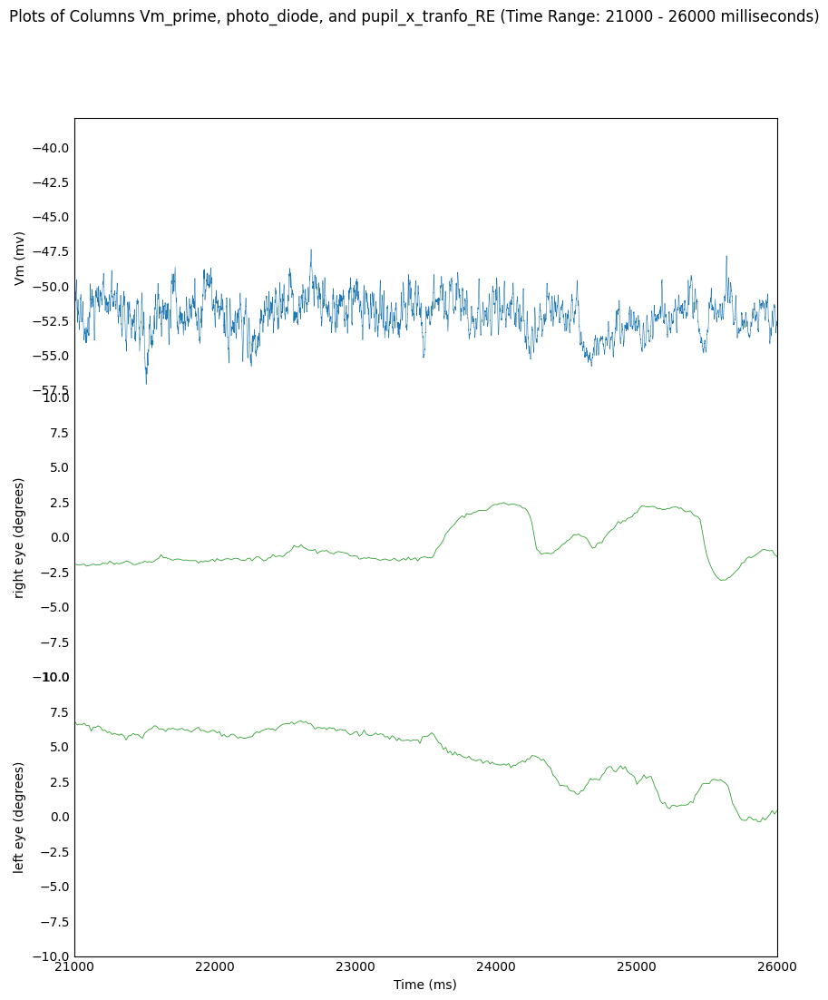

...

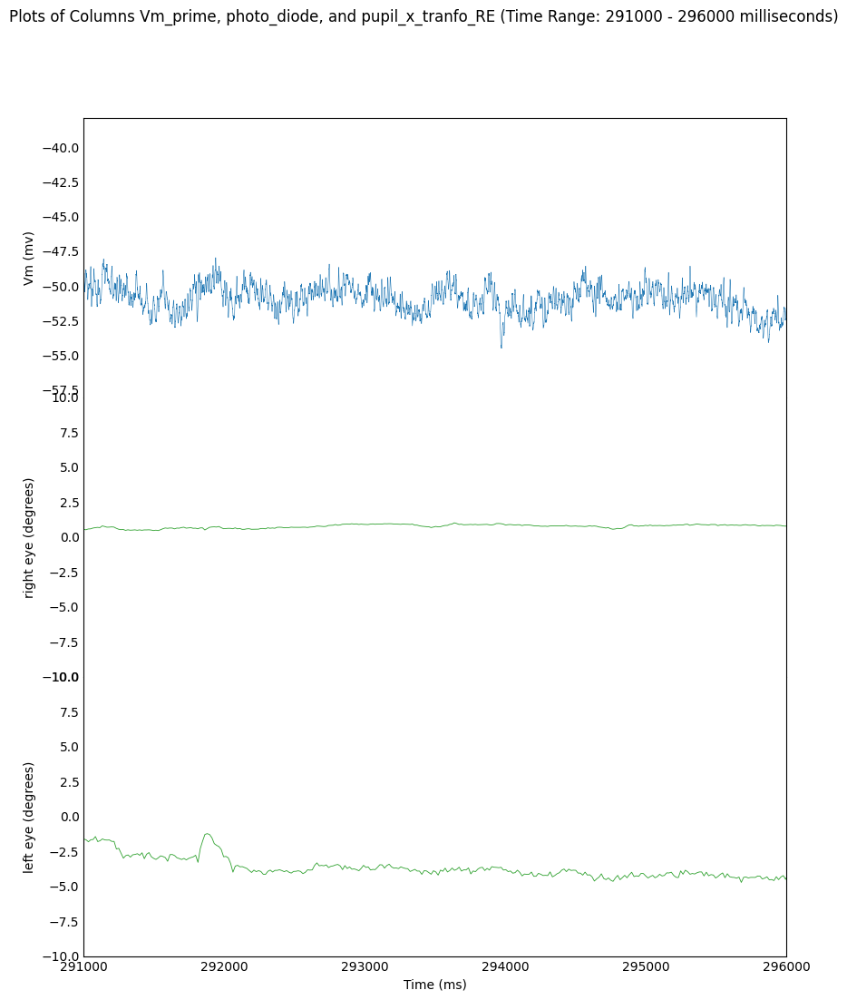

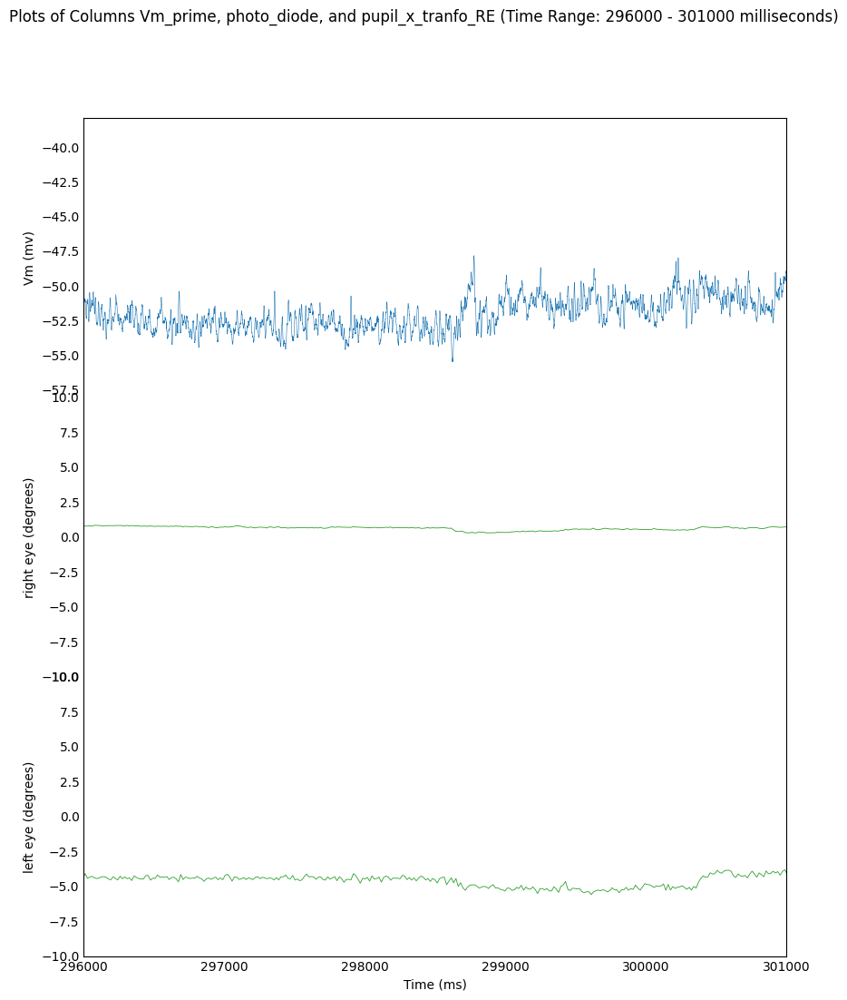

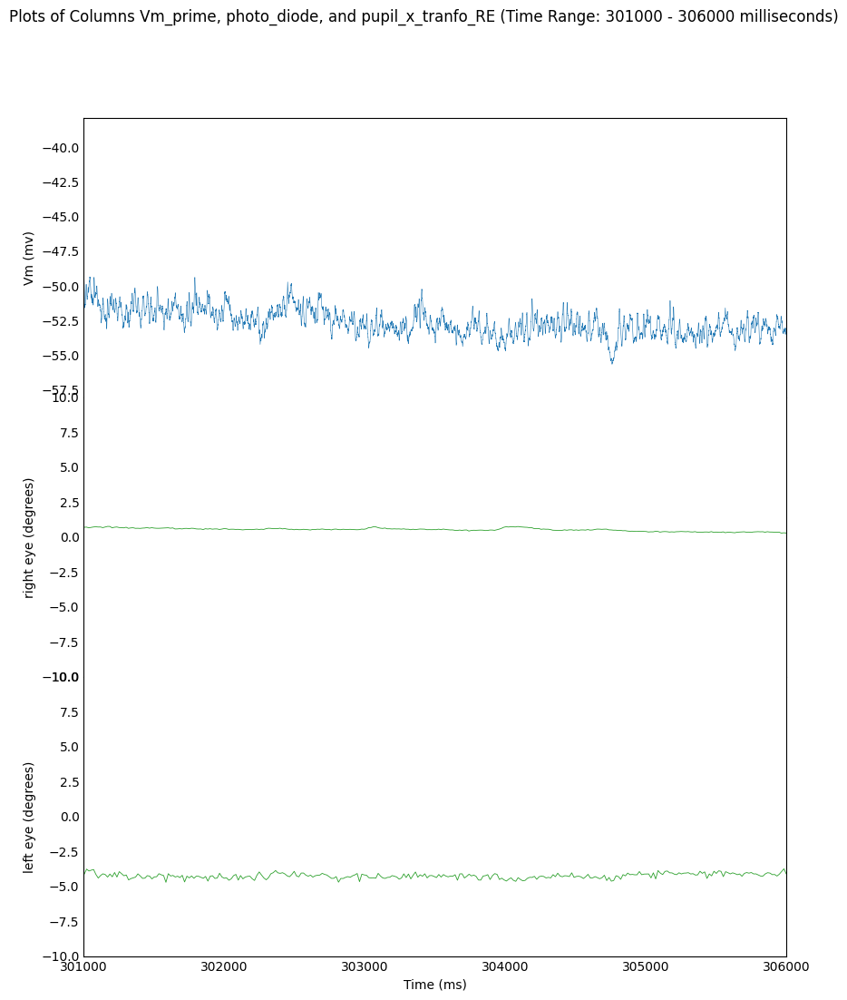

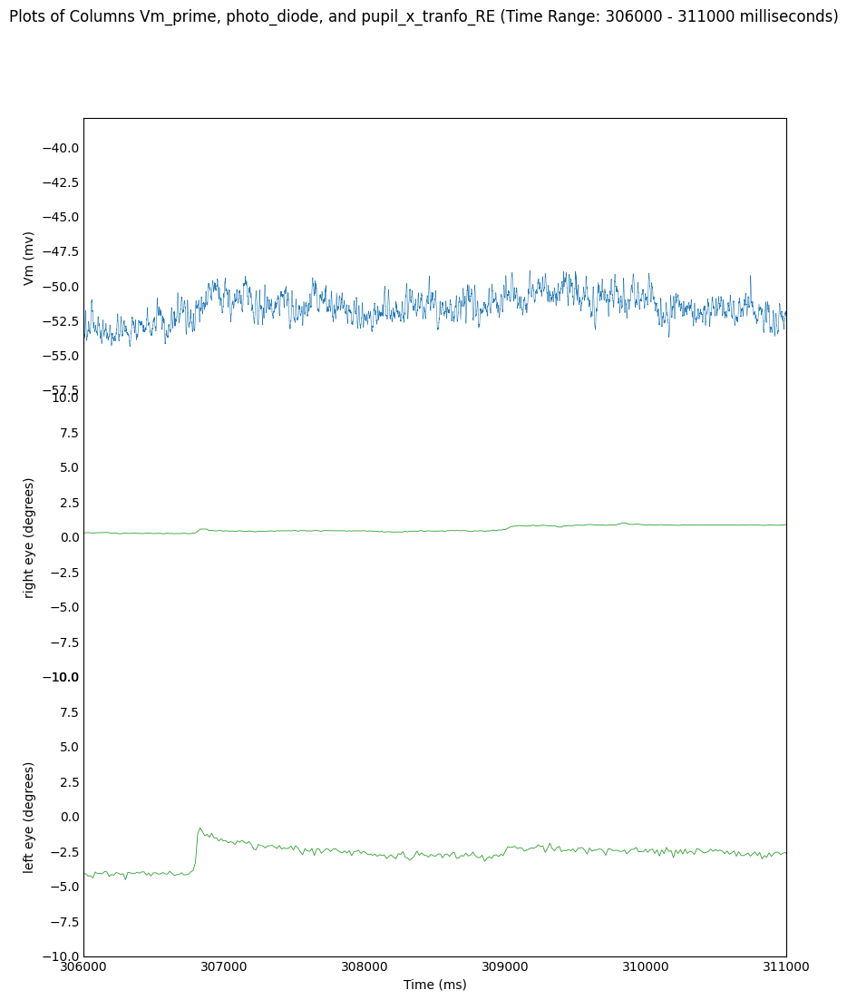

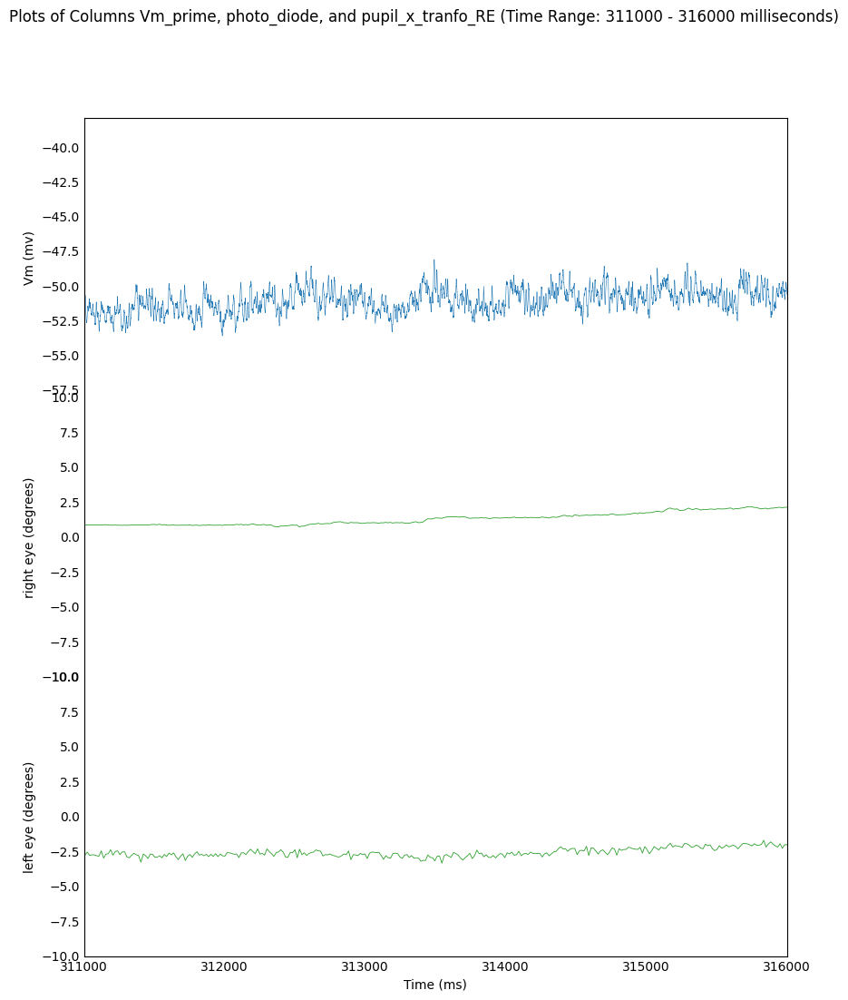

In [48]:
# Initialize the starting time
time_start = 1000
time_end = time_start + 5000

# Loop until you reach a desired end time
while time_end <= 320000:  # Adjust the end time as needed
    # Create a figure with four vertically stacked subplots
    fig, axs = plt.subplots(3, 1, figsize=(10, 12), sharex=False)

    # Define the y-axis limits for df_RE
    y_start = -10
    y_end = 10

    # Plot 'Vm_prime' on the first subplot (df_abf)
    axs[0].plot(df_abf2['time_milliseconds_zero'][first_frame_df_abf2:], df_abf2['Vm_corrected'][first_frame_df_abf2:], label='Vm_prime', color='tab:blue',linewidth=0.4)
    axs[0].set_ylabel('Vm (mv)')
    axs[0].tick_params(axis='y')
    axs[0].set_xlim(time_start, time_end)
    axs[0].set_xticks([])
    
    axs[0].spines['top'].set_visible(True)
    axs[0].spines['right'].set_visible(True)
    axs[0].spines['bottom'].set_visible(False)
    axs[0].spines['left'].set_visible(True)
    axs[0].tick_params(axis='both', which='both', length=0)

    
    # Plot 'pupil_x_tranfo_RE' from df_RE on the third subplot
    axs[1].plot(df_RE2['time_milliseconds_zero'][first_frame_df_RE2:], df_RE2['pupil_RE_x_corrected'][first_frame_df_RE2:], label='pupil_RE_x_corrected', color='tab:green',linewidth=0.6)
    axs[1].set_ylabel('right eye (degrees)')
    axs[1].tick_params(axis='y')
    axs[1].set_xlim(time_start, time_end)
    axs[1].set_xticks([])
    axs[1].set_ylim(y_start, y_end)
    
    axs[1].spines['top'].set_visible(False)
    axs[1].spines['right'].set_visible(True)
    axs[1].spines['bottom'].set_visible(False)
    axs[1].spines['left'].set_visible(True)
    axs[1].tick_params(axis='both', which='both', length=0)

    # Plot 'pupil_x_tranfo_LE' from df_LE on the fourth subplot
    axs[2].plot(df_LE2['time_milliseconds_zero'][first_frame_df_LE2:], df_LE2['pupil_LE_x_corrected'][first_frame_df_LE2:], label='pupil_LE_x_corrected', color='tab:green',linewidth=0.6)
    axs[2].set_xlabel('Time (ms)')
    axs[2].set_ylabel('left eye (degrees)')
    axs[2].tick_params(axis='y')
    axs[2].set_xlim(time_start, time_end)
    axs[2].set_ylim(y_start, y_end)
    
    axs[2].spines['top'].set_visible(False)
    axs[2].spines['right'].set_visible(True)
    axs[2].spines['bottom'].set_visible(True)
    axs[2].spines['left'].set_visible(True)
    axs[2].tick_params(axis='both', which='both', length=0)

    # Set title for the entire figure
    plt.suptitle(f'Plots of Columns Vm_prime, photo_diode, and pupil_x_tranfo_RE (Time Range: {time_start} - {time_end} milliseconds)')
    
     # Adjust spacing between subplots
    plt.subplots_adjust(hspace=0)

    # Adjust spacing between subplots
    #plt.tight_layout()

    # Define the file path and name
    file_path4 = f'D:\\230923_Patch\\3rprep\\2ndattempt\\1strecording\\Analysis\\{time_start}_{time_end}.pdf'
    

    # Save the figure as a .pdf
    plt.savefig(file_path4, format='pdf')

    # Show the plot (optional)
    plt.show()

    # Increment time_start and time_end for the next iteration
    time_start += 5000
    time_end += 5000
